## Fires from Space: Australia
#### NASA Satellite Data MODISC6 and VIIRS 375m from 2019-08-01 to 2020-01-11 (https://earthdata.nasa.gov/learn/articles/what-is-new-collection-6-modis-active-fire-data)

A temporada de incêndios florestais de 2019-2020, também conhecida como verão negro, consistiu em vários incêndios florestais extremos a partir de junho de 2019 na Austrália.

### Atributos do onjunto

- Latitude: centro de pixel de fogo de 1 km, mas não necessariamente a localização real do fogo.
- Longitude: centro de pixel de fogo de 1 km, mas não necessariamente a localização real do fogo.
- Brightness: temperatura de brilho do canal 21/22 do pixel de fogo medido em Kelvin.
- Scan: varredura ao longo do tamanho do pixel de digitalização.
- Track: caminho ao longo do tamanho do pixel da trilha.
- Acq_Date: data da aquisição do MODIS.
- Acq_Time:	hora da aquisição do MODIS.
- Satellite: satélite. A = Água e T = Terra.
- Confidence: as estimativas de confiança variam entre 0 e 100% e são atribuídas a uma das três classes de incêndio (baixa confiança, confiança nominal ou alta confiança).
- Version: versão que identifica a coleção.
- Bright_T31: temperatura de brilho do canal 31 do pixel de fogo medido em Kelvin.
- FRP: poder radiativo do fogo em MW (megawatts).
- DayNight: D = Diurno, N = Noturno.

### Import bibliotecas

In [1]:
import numpy as np
import pandas as pd
import warnings
import matplotlib
import seaborn as sns
import matplotlib.pyplot as plt

%matplotlib inline
matplotlib.style.use(['seaborn-bright'])

print ('Matplotlib version: ', matplotlib.__version__) 
print ('Numpy version: ', np.__version__) 
print ('Pandas version: ', pd.__version__)

warnings.filterwarnings('ignore')

Matplotlib version:  3.2.1
Numpy version:  1.17.4
Pandas version:  0.24.2


### Carregamento dos dados

In [2]:
df = pd.read_csv('dados/fire_archive_M6_96619.csv')
print('Dataframe shape: {}'.format(df.shape))

Dataframe shape: (36011, 15)


#### Dados nulos

In [3]:
df.isnull().mean()

latitude      0.0
longitude     0.0
brightness    0.0
scan          0.0
track         0.0
acq_date      0.0
acq_time      0.0
satellite     0.0
instrument    0.0
confidence    0.0
version       0.0
bright_t31    0.0
frp           0.0
daynight      0.0
type          0.0
dtype: float64

#### Características do conjunto

In [4]:
df.head()

,latitude,longitude,brightness,scan,track,acq_date,acq_time,satellite,instrument,confidence,version,bright_t31,frp,daynight,type
0,-11.8070,142.0583,313.0,1.0,1.0,2019-08-01,56,Terra,MODIS,48,6.3,297.3,6.6,D,0
1,-11.7924,142.0850,319.3,1.0,1.0,2019-08-01,56,Terra,MODIS,71,6.3,297.3,11.3,D,0
2,-12.8398,132.8744,311.6,3.1,1.7,2019-08-01,57,Terra,MODIS,42,6.3,298.7,23.1,D,0
3,-14.4306,143.3035,310.1,1.1,1.1,2019-08-01,57,Terra,MODIS,33,6.3,296.1,6.5,D,0
4,-12.4953,131.4897,310.3,4.0,1.9,2019-08-01,57,Terra,MODIS,36,6.3,298.8,27.6,D,0


In [5]:
df.columns.values

array(['latitude', 'longitude', 'brightness', 'scan', 'track', 'acq_date',
       'acq_time', 'satellite', 'instrument', 'confidence', 'version',
       'bright_t31', 'frp', 'daynight', 'type'], dtype=object)

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36011 entries, 0 to 36010
Data columns (total 15 columns):
latitude      36011 non-null float64
longitude     36011 non-null float64
brightness    36011 non-null float64
scan          36011 non-null float64
track         36011 non-null float64
acq_date      36011 non-null object
acq_time      36011 non-null int64
satellite     36011 non-null object
instrument    36011 non-null object
confidence    36011 non-null int64
version       36011 non-null float64
bright_t31    36011 non-null float64
frp           36011 non-null float64
daynight      36011 non-null object
type          36011 non-null int64
dtypes: float64(8), int64(3), object(4)
memory usage: 4.1+ MB


#### Criando um datetime

In [7]:
def to_hour_str(number):
    string = '{:04d}'.format(number)
    string = string[:2] + ':' + string[2:]
    return string

In [8]:
df['datetime'] = df.apply(lambda x : x['acq_date'] + " " + to_hour_str(x['acq_time']), axis=1)

### Visualização dos dados

In [9]:
import plotly.graph_objects as go

In [10]:
times = df.groupby(['acq_date'])['acq_date'].count().index.tolist()
frames_data = [df.loc[df['acq_date'] == t] for t in times]

frames= [go.Frame(data=[go.Densitymapbox(lat=f['latitude'], lon=f['longitude'], z=f['brightness'], radius=10)],
                  name=str(f.iloc[0]['acq_date'])) for f in frames_data]

In [11]:
buttons=[
         dict(label="Play", method="animate", 
              args=[None, {'fromcurrent':True, "transition": {"duration": 30, "easing": "quadratic-in-out"}}]),
    
         dict(label="Pause", method="animate", 
              args=[[None], {"frame": {"duration": 0, "redraw": False},"mode": "immediate", "transition": {"duration": 0}}])
]


sliders_dict = {
    'active':0,
    'currentvalue': dict(font=dict(size=16), prefix='Time: ', visible=True),
    "transition": {"duration": 300, "easing": "cubic-in-out"},
    'x': 0,
    'steps': []
}

for i,t in enumerate(times):
    slider_step = {"args": [
                        [t],
                        {"frame": {"duration": 300, "redraw": False},
                         "transition": {"duration": 30, "easing": "quadratic-in-out"}}
                    ],
            "label": t,
            "method": "animate",
            "value": t
    }
    sliders_dict['steps'].append(slider_step)

In [12]:
fig = go.Figure(data = [go.Densitymapbox(lat=df['latitude'], lon=df['longitude'], z=df['brightness'], 
                                         radius=1, colorscale='Hot', zmax=400, zmin=0)],
                
               layout=go.Layout(updatemenus=[dict(type="buttons", buttons=buttons,showactive=True)]), 
               frames=frames
)

fig.update_layout(mapbox_style='stamen-terrain',
                  mapbox_center_lon=135,
                  mapbox_center_lat=-25.34,
                  mapbox_zoom=3.5)


fig.update_layout(sliders=[sliders_dict],
                 title='Visualização incêndio na Austrália')

fig.update_layout(height=850)
fig.show()

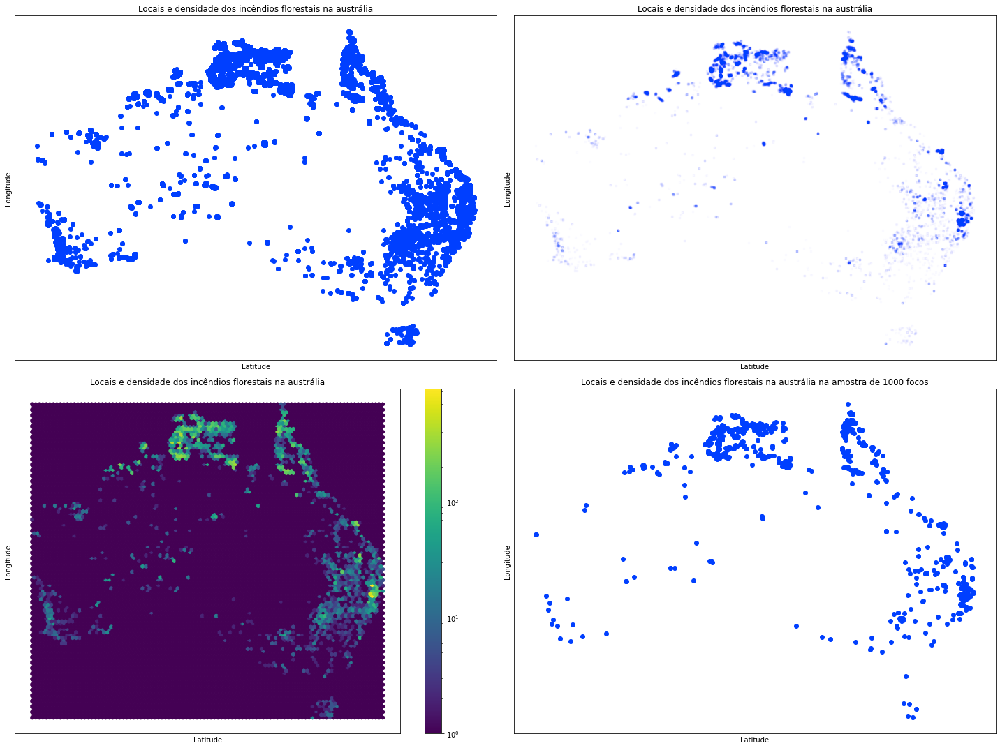

In [13]:
fig, axes = plt.subplots(2,2, figsize =(20,15), subplot_kw={'xticks': (), 'yticks': ()})

axes[0,0].scatter(df.longitude, df.latitude)
axes[0,0].set_title('Locais e densidade dos incêndios florestais na austrália', size=12)

axes[0,1].scatter(df.longitude, df.latitude, alpha=0.01, marker=".")
axes[0,1].set_title('Locais e densidade dos incêndios florestais na austrália', size=12)

img = axes[1,0].hexbin(df.longitude, df.latitude, bins='log')
axes[1,0].set_title('Locais e densidade dos incêndios florestais na austrália', size=12)

sample = df.iloc[np.random.choice(df.index, 1000)]
axes[1,1].scatter(sample.longitude, sample.latitude)
axes[1,1].set_title('Locais e densidade dos incêndios florestais na austrália na amostra de 1000 focos', size=12)

for ax in axes.ravel():
    ax.set_xlabel('Latitude')
    ax.set_ylabel('Longitude')

plt.tight_layout()
fig.colorbar(img, ax=axes[1,0])
plt.show()

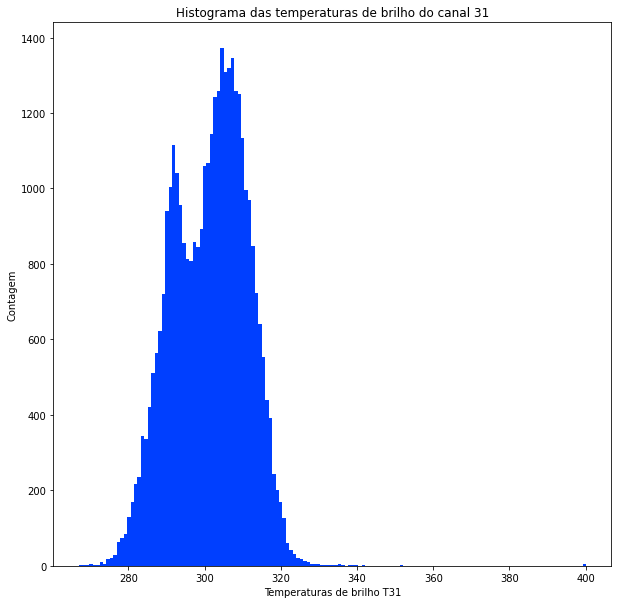

In [14]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
ax.hist(df.bright_t31, bins='auto');
ax.set_title('Histograma das temperaturas de brilho do canal 31');
ax.set_xlabel("Temperaturas de brilho T31");
ax.set_ylabel("Contagem");

In [15]:
import folium
from folium import plugins

In [16]:
f = folium.Figure(width=1000, height=500)
center_lat = -24.003249 
center_long = 133.737310

map_fire = folium.Map(location=[center_lat,center_long], control_scale=True, zoom_start=4, width=750, height=500, 
               zoom_control=True).add_to(f)

for i in range(0,df.shape[0]):    
    location=[df.iloc[i]['latitude'], df.iloc[i]['longitude']]
    folium.CircleMarker(location,radius=1,color='red').add_to(map_fire)

map_fire